# ✂️ CLIPSeg: Segmenting images with arbitrary textual prompts

**Open-vocabulary segmentation**
 is the task of segmenting objects in an image based on arbitrary text prompts (e.g., “a cat”, “a tree”, “a red car”), without limiting to pre-defined semantic classes.

**CLIPSeg** is a powerful open-vocabulary segmentation model, building on the vision-language alignment capabilities of CLIP
 and adapting it to dense prediction tasks. Instead of merely classifying entire images, CLIPSeg predicts a segmentation mask corresponding to each textual prompt, enabling fine-grained visual understanding.


The model is based on a frozen CLIP backbone and introduces a lightweight transformer-based decoder to produce pixel-level outputs. CLIPSeg employs a [**Feature-wise Linear Transformation (FiLM)**](https://distill.pub/2018/feature-wise-transformations/) module to inform the vision decoder of textual information.

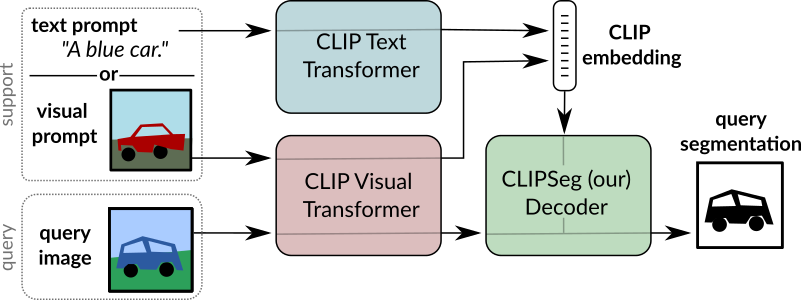

Source: https://github.com/timojl/clipseg/blob/master/overview.png

👉 Original Paper: https://arxiv.org/abs/2112.10003

👉 GitHub Repo: https://github.com/timojl/clipseg


# Summary of the Notebook

⚙️ Author: Tianyi Gao (t.gao@wustl.edu)

This notebook mainly includes the following three parts:


---


**(1) How to Run Open-Vocabulary Segmentation with CLIPSeg**  
🚀 Includes a pipeline for inference, along with helper functions for image loading and visualization.  

**(2) Analyzing CLIPSeg with Different Inputs**  
- 🌐 **Common sense / world knowledge**: Evaluate CLIPSeg’s ability to leverage broad knowledge for segmentation.  
- 🎨 **Color & spatial relationships**: Test performance on tasks involving color identification and spatial reasoning.  
- 🌍 **Geographic generalization**: Assess robustness across different geographic contexts.  
- 🛰️ **Earth observation domain**: Explore applications in remote sensing and Earth observation imagery.  

**(3) Demonstrate a Potential Downstream Application**  
- Use CLIPSeg as a preprocessing tool for Stable Diffusion v2 **inpainting**.  
- 🖼️ *Say it and erase it!* Generate edited images by combining text-driven segmentation with diffusion-based synthesis.

---

📖 Reference:


Hugging Face has integrated CLIPSeg & Stable Diffusion into the transformers library, so we adopt their high-level functions here.


👉 https://huggingface.co/docs/transformers/main/en/model_doc/clipseg

👉 https://huggingface.co/stabilityai/stable-diffusion-2-inpainting


# Setting up the environment & Importing dependencies
Please make sure the notebook is running in a GPU environment. I'm using Google Colab (A100 GPU) for reference.

In [1]:
! pip install transformers

# for downstrean task demonstration (inpainting)
! pip install diffusers accelerate scipy safetensors


Hugging Face has integrated CLIPSeg into the transformers library, so we adopt their high-level functions here.


In [2]:
import matplotlib.pyplot as plt
import numpy as np
import requests
from io import BytesIO
from PIL import Image

from transformers import AutoProcessor, CLIPSegForImageSegmentation
from transformers.image_utils import load_image
import torch
import torch.nn.functional as F

# for downstrean task demonstration (inpainting)
from diffusers import StableDiffusionInpaintPipeline

# Defining utility functions

`visualize_masks_on_image`: Resizes predicted probability masks to the original image dimensions and overlays them on the input image for side-by-side visualization with corresponding text prompts.

`load_wiki_images`: Downloads images from given URLs (e.g., Wikimedia), resizes them to a target size, and returns them as PIL images for further processing.

In [3]:
def visualize_masks_on_image(image, probs, texts):
    """
    Resize predicted masks to the original image size and overlay them with visualization.

    Args:
        image (PIL.Image): Original input image.
        probs (Tensor): Tensor of shape (N, H', W') representing predicted probability masks.
        texts (List[str]): List of text prompts corresponding to each mask.
    """
    # Resize masks back to original image size
    orig_w, orig_h = image.size
    resized_masks = F.interpolate(
        probs.unsqueeze(1),  # (N, 1, H', W')
        size=(orig_h, orig_w),
        mode="bilinear",
        align_corners=False
    ).squeeze(1)  # (N, H, W)

    # Visualization
    fig, axes = plt.subplots(1, len(texts) + 1, figsize=(5 * (len(texts) + 1), 5))
    axes[0].imshow(image)
    axes[0].set_title("Original",fontsize=16)
    axes[0].axis("off")

    for i, text in enumerate(texts):
        mask = resized_masks[i].cpu().numpy()
        axes[i + 1].imshow(image)
        axes[i + 1].imshow(mask, cmap="jet", alpha=0.5)
        axes[i + 1].set_title(text,fontsize=16)
        axes[i + 1].axis("off")

    plt.tight_layout()
    plt.show()


def load_wiki_images(urls, size=(256, 256)):
    """
    Download and resize images from a list of URLs.

    Args:
        urls (list of str): List of image URLs (e.g., from Wikimedia).
        size (tuple): Target size (width, height) for resizing the images.

    Returns:
        List of PIL.Image.Image: Successfully loaded and resized PIL images.
    """
    headers = {"User-Agent": "Mozilla/5.0"}
    images = []

    for url in urls:
        try:
            # Download and open the image from URL, then resize it
            response = requests.get(url, headers=headers)
            img = Image.open(BytesIO(response.content)).resize(size)
            images.append((img, url.split("/")[-1]))  # Save image and filename
        except Exception as e:
            print(f"Error loading {url}:", e)

    if not images:
        print("No images loaded.")
        return []

    return [img for img, _ in images]


# Loading processor and model
HuggingFace wraps a image preprocessor and a text tokenizer into one single processor.


In [4]:
processor = AutoProcessor.from_pretrained("CIDAS/clipseg-rd64-refined")
model = CLIPSegForImageSegmentation.from_pretrained("CIDAS/clipseg-rd64-refined",return_dict=True)

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Fetching 1 files:   0%|          | 0/1 [00:00<?, ?it/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


Fetching 1 files:   0%|          | 0/1 [00:00<?, ?it/s]

# Inference
We can utilize CLIPSeg to segment any objects in given query image via modifying the `text_prompts`.

/usr/local/lib/python3.12/dist-packages/transformers/image_processing_utils.py:51: UserWarning: The following named arguments are not valid for `ViTImageProcessor.preprocess` and were ignored: 'padding'
  return self.preprocess(images, **kwargs)


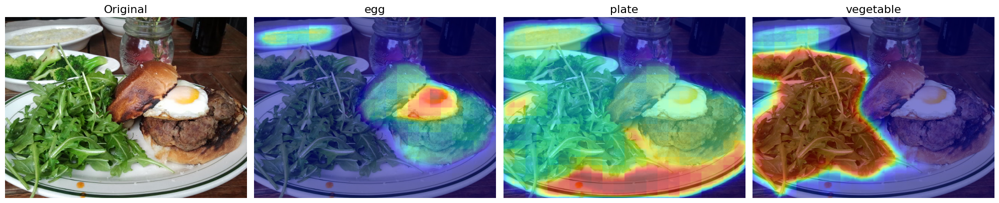

In [5]:
# define objects to segment
text_prompts = ["egg", "plate", "vegetable"]
# Load an example image
url = "http://farm8.staticflickr.com/7010/6555342219_b2cee7f19c_z.jpg"
image = load_image(url)

# Preprocess
inputs = processor(text=text_prompts, images=[image] * len(text_prompts), padding=True, return_tensors="pt")
outputs = model(**inputs)

# Inference
with torch.inference_mode():
    outputs = model(**inputs)
logits = outputs.logits  # [num_prompts, H, W]
# Convert to probability masks
probs = torch.sigmoid(logits)

visualize_masks_on_image(image, probs, text_prompts)

# 🌐 More analysis: common sense or world knowledge
We can segment objects based on descriptions of their **attributes** or **affordances**.

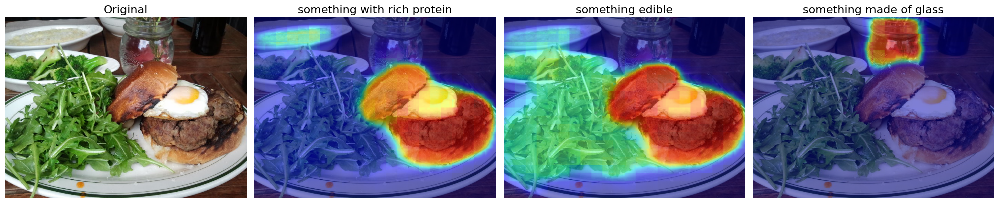

In [6]:
# define objects to segment
text_prompts = ["something with rich protein", "something edible", "something made of glass"]
# Load an example image
url = "http://farm8.staticflickr.com/7010/6555342219_b2cee7f19c_z.jpg"
image = load_image(url)

# Preprocess
inputs = processor(text=text_prompts, images=[image] * len(text_prompts), padding=True, return_tensors="pt")
outputs = model(**inputs)

# Inference
with torch.inference_mode():
    outputs = model(**inputs)
logits = outputs.logits  # [num_prompts, H, W]
# Convert to probability masks
probs = torch.sigmoid(logits)

visualize_masks_on_image(image, probs, text_prompts)

We also tried a picture of Minecraft.

*   It can recognize in-game characters as well as the word "Minecraft".
*   The model overlooks the nearby iron ore, yet labels a far-off mountain — maybe it's a mine?



In [7]:
# Wrapper function: Segment an image based on text prompts and visualize the results
def segment_and_visualize(image_url, text_prompts, size=(384, 384)):
    # Load image
    image = load_wiki_images([image_url], size=size)[0]

    # Preprocess
    inputs = processor(text=text_prompts, images=[image] * len(text_prompts), padding=True, return_tensors="pt")

    # Inference
    with torch.inference_mode():
        logits = model(**inputs).logits  # [num_prompts, H, W]

    # Probability masks
    probs = torch.sigmoid(logits)

    # Visualization
    visualize_masks_on_image(image, probs, text_prompts)

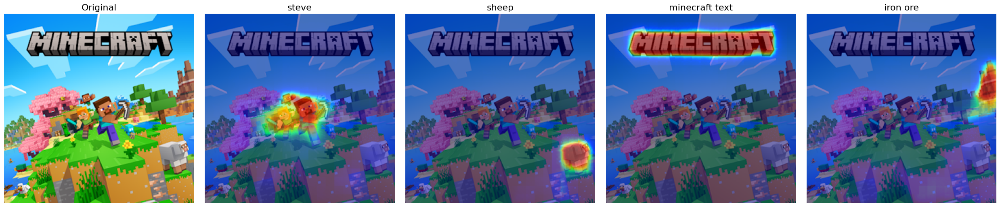

In [8]:
# Minecraft
segment_and_visualize(
    image_url="https://upload.wikimedia.org/wikipedia/en/b/b6/Minecraft_2024_cover_art.png",
    text_prompts=["steve", "sheep", "minecraft text", "iron ore"]
)

# 🎨 More analysis: color & spatial relationship understanding
The following example demonstrates that while CLIPSeg is effective at recognizing color attributes, it has difficulty understanding complex spatial relationships, as evidenced by the prompts "a die with three facing up" and "a die stacked on top of other dice."

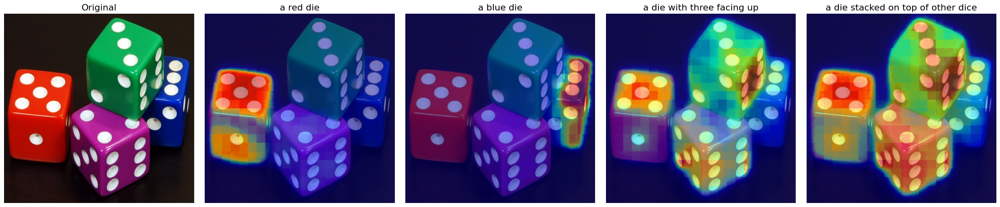

In [9]:
# Run on Dice image
segment_and_visualize(
    image_url="https://upload.wikimedia.org/wikipedia/commons/1/1c/6sided_dice_%28cropped%29.jpg",
    text_prompts=["a red die", "a blue die", "a die with three facing up", "a die stacked on top of other dice"]
)

Similarly, in this example, CLIPSeg is good at identifying **color** but poor at **spatial reasoning**.

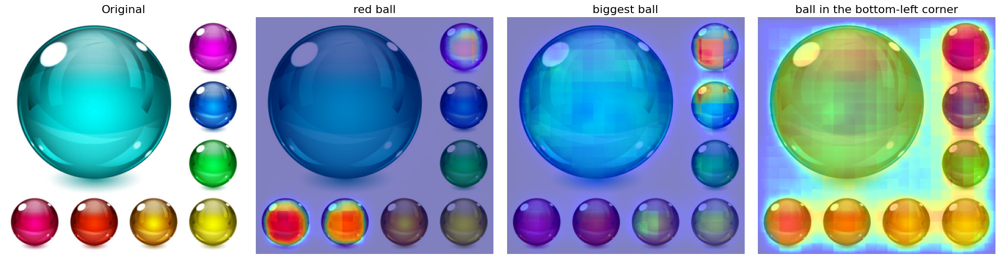

In [10]:
# Run on Ball image
segment_and_visualize(
    image_url="https://media.istockphoto.com/id/490820137/vector/multicolored-spheres.jpg?s=612x612&w=0&k=20&c=g5ddnBdFcB0THLjZJ6TsT471Jk0GIN2S8KsW9TNDkl0=",
    text_prompts=["red ball", "biggest ball", "ball in the bottom-left corner"]
)

# 🌍 More analysis: geographic generalization
We also take a look at how well CLIP can generalize across images from different geographic regions through the lens of segmentation.

Take *"stove"* as an example:

- The segmentation performance varies across different geographies and tends to be weaker on data that appears less frequently on the internet.
- When segmenting with affordance hints, some cases improved while others worsened, suggesting that the affordance understanding capability of CLIPSeg is not **geographically robust**.  
- It's interesting to see that combining the category label with the affordance description can, to some extent, improve the segmentation results **(see the 1st–3rd rows)**. Based on this, are there prompt engineering techniques that can improve a model’s geographic generalization in a training-free manner?

Processing: https://www.shutterstock.com/image-photo/male-chef-makes-bread-shape-600nw-2179990631.jpg


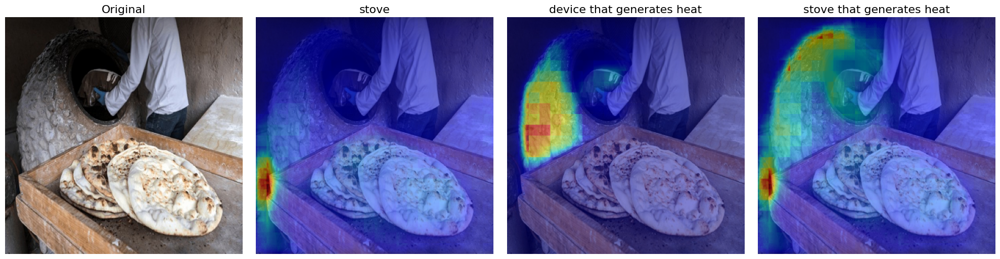

Processing: https://upload.wikimedia.org/wikipedia/commons/thumb/3/39/Kookplaat_inductie.JPG/1920px-Kookplaat_inductie.JPG


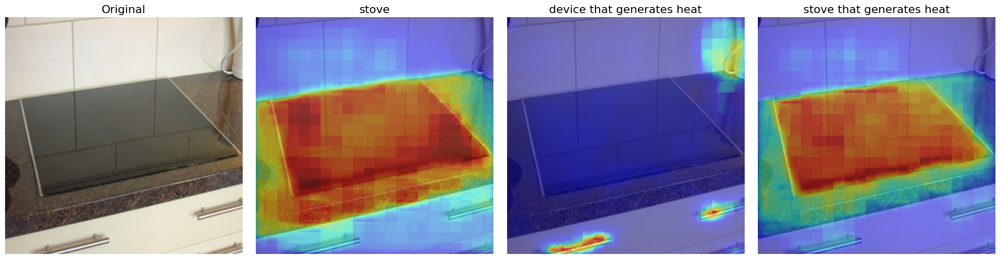

Processing: https://upload.wikimedia.org/wikipedia/commons/thumb/b/b3/Stove%2CLPG%2Cfree_distribution%2CTamil_Nadu470.jpg/1920px-Stove%2CLPG%2Cfree_distribution%2CTamil_Nadu470.jpg


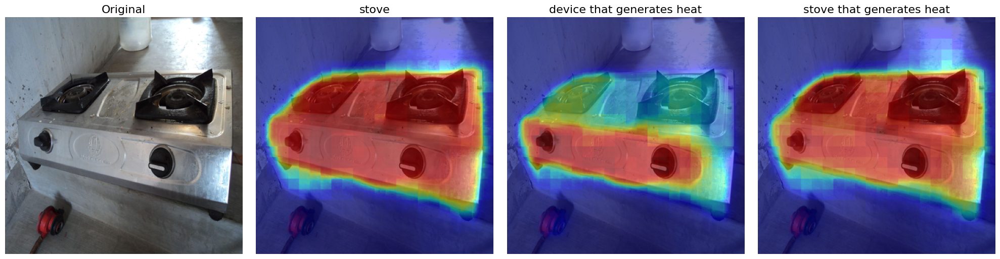

Processing: https://upload.wikimedia.org/wikipedia/commons/thumb/7/75/Stove%2C_Ethnographic_Museum%2C_Belgrade.jpg/1280px-Stove%2C_Ethnographic_Museum%2C_Belgrade.jpg


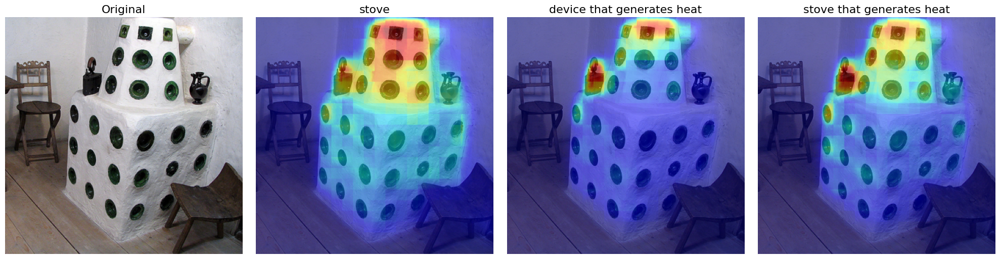

Processing: https://upload.wikimedia.org/wikipedia/commons/thumb/9/9f/%D0%9C%D1%83%D0%B7%D0%B5%D0%B9_%D0%9A%D0%B0%D0%B7%D0%B0%D1%87%D0%B8%D0%B9_%D0%BA%D1%83%D1%80%D0%B5%D0%BD%D1%8C_%2878%29.jpg/1920px-%D0%9C%D1%83%D0%B7%D0%B5%D0%B9_%D0%9A%D0%B0%D0%B7%D0%B0%D1%87%D0%B8%D0%B9_%D0%BA%D1%83%D1%80%D0%B5%D0%BD%D1%8C_%2878%29.jpg


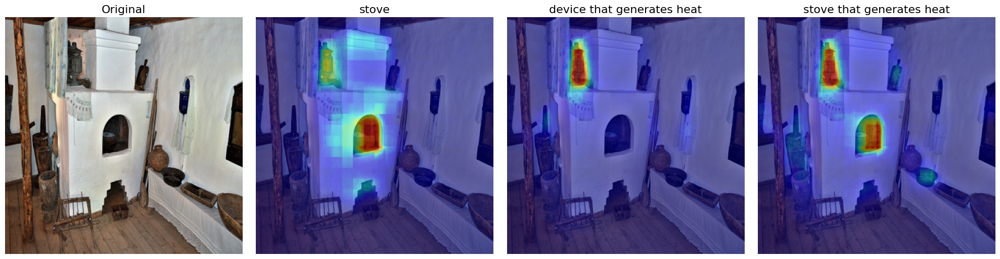

In [11]:
# Stove images from around the world
urls = [
    "https://www.shutterstock.com/image-photo/male-chef-makes-bread-shape-600nw-2179990631.jpg",
    "https://upload.wikimedia.org/wikipedia/commons/thumb/3/39/Kookplaat_inductie.JPG/1920px-Kookplaat_inductie.JPG",
    "https://upload.wikimedia.org/wikipedia/commons/thumb/b/b3/Stove%2CLPG%2Cfree_distribution%2CTamil_Nadu470.jpg/1920px-Stove%2CLPG%2Cfree_distribution%2CTamil_Nadu470.jpg",
    "https://upload.wikimedia.org/wikipedia/commons/thumb/7/75/Stove%2C_Ethnographic_Museum%2C_Belgrade.jpg/1280px-Stove%2C_Ethnographic_Museum%2C_Belgrade.jpg",
    "https://upload.wikimedia.org/wikipedia/commons/thumb/9/9f/%D0%9C%D1%83%D0%B7%D0%B5%D0%B9_%D0%9A%D0%B0%D0%B7%D0%B0%D1%87%D0%B8%D0%B9_%D0%BA%D1%83%D1%80%D0%B5%D0%BD%D1%8C_%2878%29.jpg/1920px-%D0%9C%D1%83%D0%B7%D0%B5%D0%B9_%D0%9A%D0%B0%D0%B7%D0%B0%D1%87%D0%B8%D0%B9_%D0%BA%D1%83%D1%80%D0%B5%D0%BD%D1%8C_%2878%29.jpg",
]

# category label, affordance description, category label + affordance description
text_prompts = ["stove", "device that generates heat", "stove that generates heat"]

for url in urls:
    print(f"Processing: {url}")
    segment_and_visualize(
        image_url=url,
        text_prompts=text_prompts
    )


# 🛰️ More analysis: applied to Earth obeservaiton domain
EO imagery provides a global lens for mapping, vital for disaster response and sustainability.

It appears that CLIPSeg exhibits a certain degree of generalization to high-resolution optical images. However, its performance tends to decline on relatively lower-resolution imagery, such as Sentinel-2 data with a 10-meter spatial resolution.

**It highlights both the potential and the need for further adaptation.**

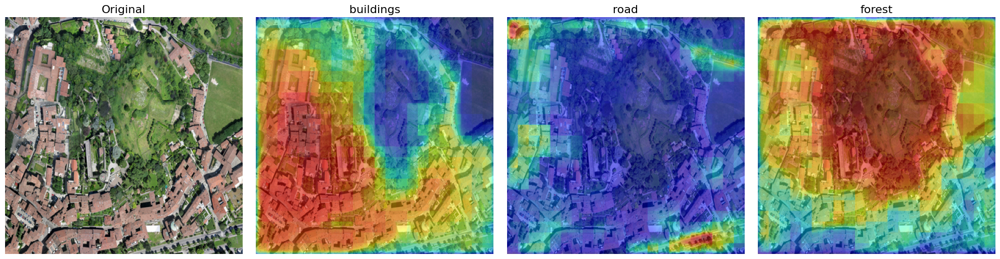

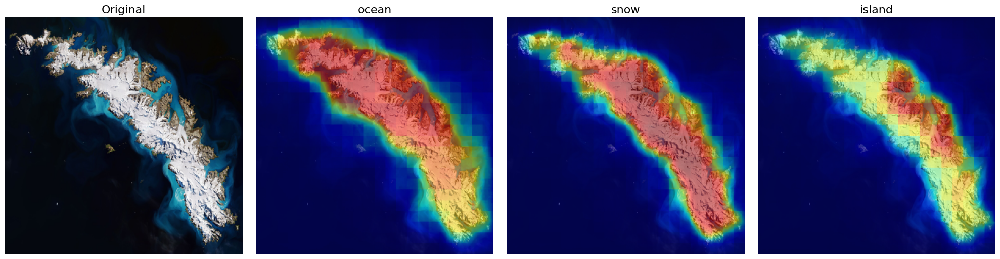

In [12]:
# Run on high-res satellite image
segment_and_visualize(
    image_url="https://upload.wikimedia.org/wikipedia/commons/thumb/e/e4/Ortofoto_Citt%C3%A0_Alta%2C_Rocca.jpg/1920px-Ortofoto_Citt%C3%A0_Alta%2C_Rocca.jpg",
    text_prompts=["buildings", "road", "forest"]
)

# Run on low-res satellite image
segment_and_visualize(
    image_url="https://upload.wikimedia.org/wikipedia/commons/thumb/3/32/South_Georgia_Island_as_seen_by_Sentinel-2.jpg/1920px-South_Georgia_Island_as_seen_by_Sentinel-2.jpg",
    text_prompts=["ocean", "snow", "island"]
)


# 🖼️ Downstream application: image inpainting with SD
CLIPSeg can provide **inpainting masks** in a flexible zero-shot manner.

In this notebook, we utilize [Stable Diffusion v2](https://huggingface.co/stabilityai/stable-diffusion-2) as our inpainting model.

## Load Stable Diffusion v2

In [13]:
# load inpainting pipeline
pipe = StableDiffusionInpaintPipeline.from_pretrained(
    "stabilityai/stable-diffusion-2-inpainting",
    torch_dtype=torch.float16,
)
pipe.to("cuda")


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!


StableDiffusionInpaintPipeline {
  "_class_name": "StableDiffusionInpaintPipeline",
  "_diffusers_version": "0.35.1",
  "_name_or_path": "stabilityai/stable-diffusion-2-inpainting",
  "feature_extractor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "image_encoder": [
    null,
    null
  ],
  "requires_safety_checker": false,
  "safety_checker": [
    null,
    null
  ],
  "scheduler": [
    "diffusers",
    "PNDMScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

## Inpaint with CLIPSeg

The block below edits the masked region specified by `text_prompts` to align with a new prompt specified by `edit_prompt`.

  0%|          | 0/50 [00:00<?, ?it/s]

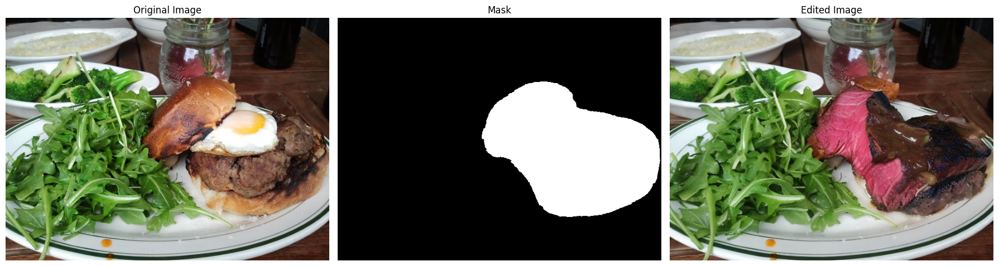

In [14]:
# 0. segmentation prompt & inpainting prompt
text_prompts = ["hamburger"]
edit_prompt = "a photo of steak"

# 1. Load image from URL
url = "http://farm8.staticflickr.com/7010/6555342219_b2cee7f19c_z.jpg"
image = load_image(url)
orig_w, orig_h = image.size  # get original size

# 2. CLIPSeg: segment object described by text
inputs = processor(text=text_prompts, images=[image] * len(text_prompts), padding=True, return_tensors="pt")
with torch.inference_mode():
    logits = model(**inputs).logits
    probs = torch.sigmoid(logits)

# 3. Resize the probability map back to original image size
resized_probs = F.interpolate(
    probs.unsqueeze(1),             # shape: [1, 1, H, W]
    size=(orig_h, orig_w),          # target size
    mode="bilinear",
    align_corners=False
).squeeze(1)  # shape: [1, H_orig, W_orig]

# 4. Convert to binary mask (threshold = 0.5)
inpainting_mask = 255 * (resized_probs[0] > 0.5).cpu().numpy().astype("uint8")
mask_pil = Image.fromarray(inpainting_mask)

# 5. Inpainting with SD v2
# strength ∈ [0.0, 1.0]: higher = more change, lower = more similar to original
result = pipe(
    prompt=edit_prompt,
    image=image,
    mask_image=mask_pil,
    strength=1.0  # try values like 0.3, 0.5, 0.9 to see the effect
).images[0]
result = result.resize(image.size)

# Visualize
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

axes[0].imshow(image)
axes[0].set_title("Original Image")
axes[0].axis("off")

axes[1].imshow(mask_pil, cmap="gray")
axes[1].set_title("Mask")
axes[1].axis("off")

axes[2].imshow(result)
axes[2].set_title("Edited Image")
axes[2].axis("off")

plt.tight_layout()
plt.show()

👻 The process may also fail due to the capability of Stable Diffusion models.

  0%|          | 0/50 [00:00<?, ?it/s]

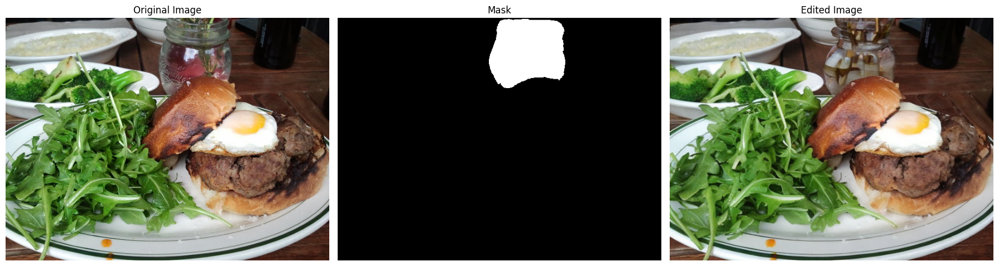

In [15]:
# 0. segmentation prompt & inpainting prompt
text_prompts = ["jar"]
edit_prompt = "apple"

# 1. Load image from URL
url = "http://farm8.staticflickr.com/7010/6555342219_b2cee7f19c_z.jpg"
image = load_image(url)
orig_w, orig_h = image.size  # get original size

# 2. CLIPSeg: segment object described by text
inputs = processor(text=text_prompts, images=[image] * len(text_prompts), padding=True, return_tensors="pt")
with torch.inference_mode():
    logits = model(**inputs).logits
    probs = torch.sigmoid(logits)

# 3. Resize the probability map back to original image size
resized_probs = F.interpolate(
    probs.unsqueeze(1),             # shape: [1, 1, H, W]
    size=(orig_h, orig_w),          # target size
    mode="bilinear",
    align_corners=False
).squeeze(1)  # shape: [1, H_orig, W_orig]

# 4. Convert to binary mask (threshold = 0.5)
inpainting_mask = 255 * (resized_probs[0] > 0.5).cpu().numpy().astype("uint8")
mask_pil = Image.fromarray(inpainting_mask)

# 5. Inpainting with SD v2
# strength ∈ [0.0, 1.0]: higher = more change, lower = more similar to original
result = pipe(
    prompt=edit_prompt,
    image=image,
    mask_image=mask_pil,
    strength=1.0  # try values like 0.3, 0.5, 0.9 to see the effect
).images[0]
result = result.resize(image.size)

# Visualize
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

axes[0].imshow(image)
axes[0].set_title("Original Image")
axes[0].axis("off")

axes[1].imshow(mask_pil, cmap="gray")
axes[1].set_title("Mask")
axes[1].axis("off")

axes[2].imshow(result)
axes[2].set_title("Edited Image")
axes[2].axis("off")

plt.tight_layout()
plt.show()